# Standard classify model

In [2]:
import tensorflow as tf
import numpy as np
from PIL import Image
from IPython.display import display

In [3]:
class StandardClassifier:
    classes = [
        'Mis Orientation',
        'Non Standard',
        'Others',
        'Standard'
    ]
    
    def __init__(self, model_path):
        # Load the TFLite model and allocate tensors
        self.model = tf.lite.Interpreter(model_path=model_path)
        self.model.allocate_tensors()
        
        # Get input and output tensor details
        self.input_details = self.model.get_input_details()
        self.output_details = self.model.get_output_details()
        
    def predict(self, image, imgsz=640):
        # pre-process the image
        resized_image = image.resize((imgsz, imgsz))
        input_data = np.array(resized_image).astype(np.float32) / 255.0 # for narm image
        input_data = np.expand_dims(input_data, axis=0)  
        
        # attach the input
        self.model.set_tensor(self.input_details[0]['index'], input_data)
        # forward
        self.model.invoke()
        # get the output
        output_data = self.model.get_tensor(self.output_details[0]['index'])
        
        class_id = np.argmax(output_data[0])
        class_name = StandardClassifier.classes[class_id]
        confidence = output_data[0][class_id]
        
        return {
            'Class_ID': class_id,
            'Class_Name': class_name,
            'Confidence': confidence
        }

# Example 1

In [4]:
# load a model
classifier = StandardClassifier("model_saves/standard_classify_model_v3.tflite")

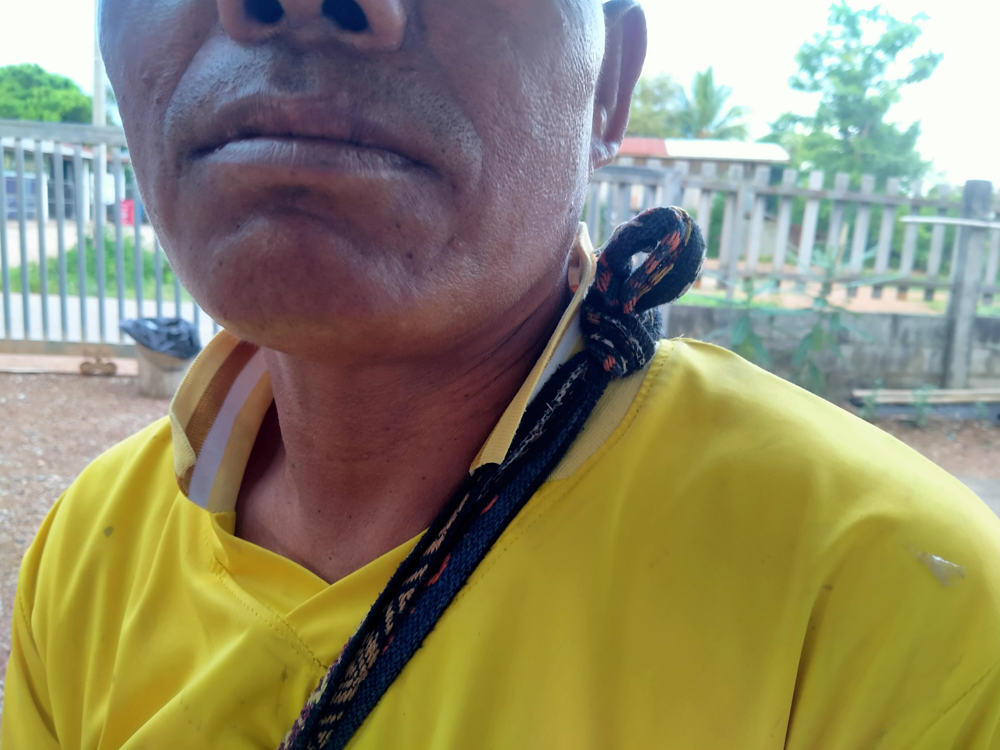

Image size: (4000, 3000)


In [5]:
# read a image
image_path = "example_images/FL_IMG20240606180727.jpg"  # Replace with the path to your image
image = Image.open(image_path)

# show and print size of the image
display(image)
print('Image size:', image.size)

In [6]:
# predict
result = classifier.predict(image, imgsz=256)

In [7]:
# show the result
result

{'Class_ID': 1, 'Class_Name': 'Non Standard', 'Confidence': 0.9999901}

# Example 2

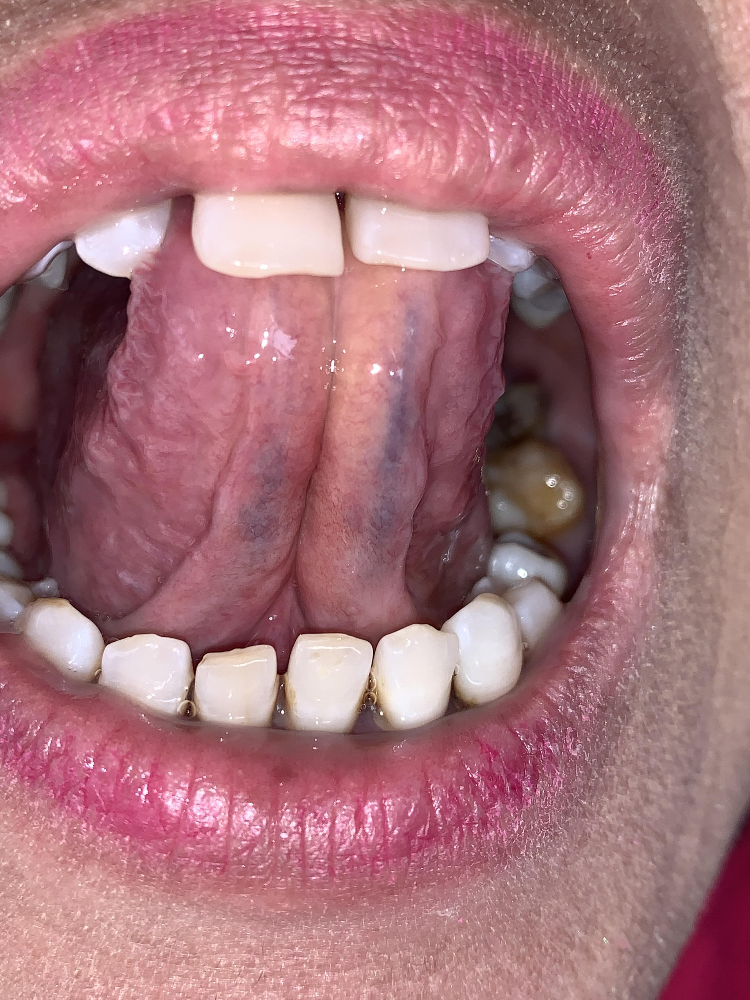

Image size: (3024, 4032)


In [8]:
# read a image
image_path = "example_images/FMVT_IMG_7157.jpg"  # Replace with the path to your image
image = Image.open(image_path)

# show and print size of the image
display(image)
print('Image size:', image.size)

In [9]:
# predict
result = classifier.predict(image, imgsz=256)

# show the result
result

{'Class_ID': 3, 'Class_Name': 'Standard', 'Confidence': 1.0}

# Example 3

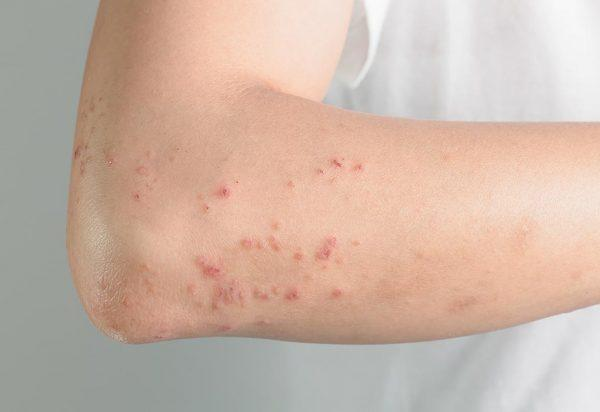

Image size: (600, 412)


In [9]:
# read a image
image_path = "example_images/lot1_1_12.jpg"  # Replace with the path to your image
image = Image.open(image_path)

# show and print size of the image
display(image)
print('Image size:', image.size)

In [10]:
# predict
result = classifier.predict(image, imgsz=256)

# show the result
result

{'Class_ID': 2, 'Class_Name': 'Others', 'Confidence': 0.99993443}

# Example 4

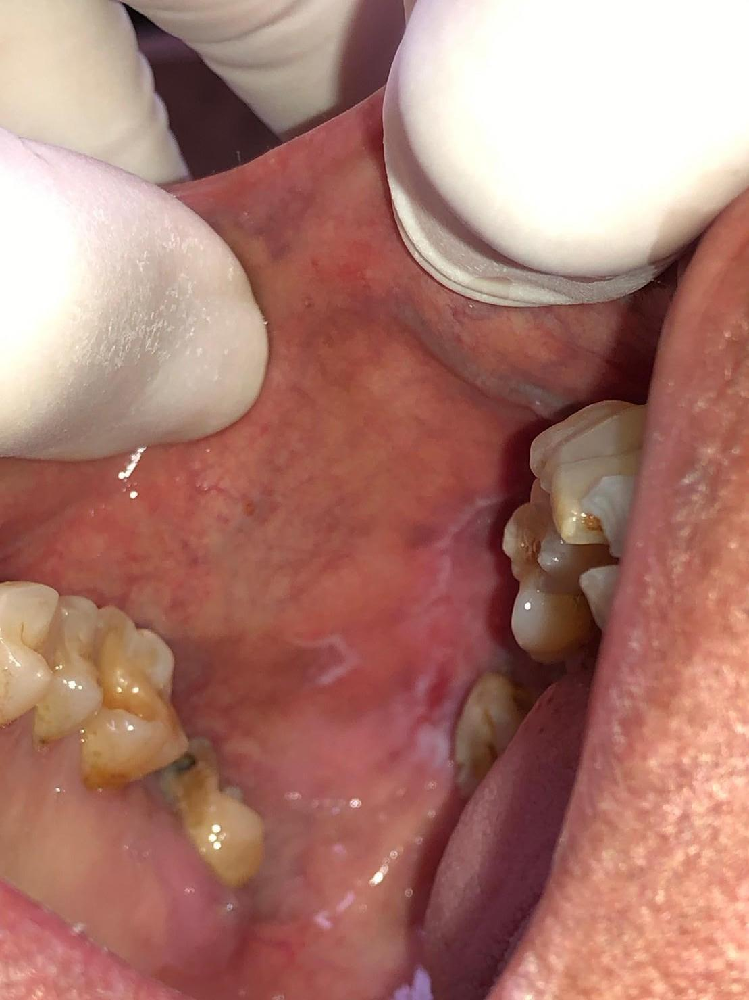

Image size: (1109, 1479)


In [11]:
# read a image
image_path = "example_images/LBM_lip (23)_d270.jpg"  # Replace with the path to your image
image = Image.open(image_path)

# show and print size of the image
display(image)
print('Image size:', image.size)

In [12]:
# predict
result = classifier.predict(image, imgsz=256)

# show the result
result

{'Class_ID': 0, 'Class_Name': 'Mis Orientation', 'Confidence': 0.99999833}